## Analyzing Evolution of alignn model


## Overview

This notebook provides a comprehensive analysis of the evolution of ALIGNN models throughout an active learning process. The analysis examines how model behavior changes as training data increases across three iterations of active learning.

### Research Questions
- How do model prediction errors evolve with increasing training data?
- How do the geometric properties of the loss landscape change during training?
- What can Hessian eigenvalue analysis tell us about model optimization characteristics?

### Experimental Setup
- **3 iterations** of active learning with progressively larger training datasets
- **3 models per iteration** (alignn_1, alignn_2, alignn_3) for statistical robustness
- Target property: Formation energy (dHf)

### Analysis Framework
1. **Quantitative Performance Analysis**: Model prediction error on different test sets
2. **Optimization Landscape Analysis**: Hessian eigenvalue computation and interpretation
3. **Loss Landscape Visualization**: Qualitative assessment of loss landscape flatness and geometry

### Key Datasets
- **Training sets**: Progressively expanded through active learning
- **Test sets**: Fixed test set, High Uncertainty (HU), Low Uncertainty (LU), and holdout sets


## 1. Environment Setup and Data Loading

### Import Required Libraries
Setting up the analysis environment with necessary libraries for data manipulation, visualization, and numerical computation.


In [ ]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, message="'force_all_finite' was renamed to 'ensure_all_finite'")

### Load Pre-computed Loss Landscape Data

Loading loss landscape data that was previously computed for all 9 models (3 iterations × 3 models each). These loss landscapes were generated for all 9760 samples using Hessian eigenvector computed on the 250 samples with lowest prediction error for each model.

In [2]:
folders = [r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter1_alignn1_lowest250_error', r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter2_alignn1_lowest250_error', r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter3_alignn1_lowest250_error',
            r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter1_alignn2_lowest250_error', r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter2_alignn2_lowest250_error', r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter3_alignn2_lowest250_error',
            r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter1_alignn3_lowest250_error', r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter2_alignn3_lowest250_error', r'computed_loss_landscapes\fixed_Aug5_all_labeled_ON_EIGVEC_iter3_alignn3_lowest250_error']

In [ ]:
loss_function_dicts = []
for folder in folders:
    with open(os.path.join(folder,'processed_loss_function_dict.pkl'), 'rb') as file:
        loss_function_dicts.append(pickle.load(file))


# Merge all dictionaries from loss_function_dicts into a single dictionary
merged_loss_function_dict = {}
for d in loss_function_dicts:
    for key, value in d.items():
        if key not in merged_loss_function_dict:
            merged_loss_function_dict[key] = value
        else:
            # If key exists, update/append values
            merged_loss_function_dict[key].update(value)

# Update the loss_function_dict to use merged version
loss_function_dict = merged_loss_function_dict

with open(os.path.join(folders[0],'feat_sample_df.pkl'), 'rb') as file:
    feat_sample_df = pickle.load(file)

with open(os.path.join(folders[0],'feat_sample_composition_df.pkl'), 'rb') as file:
    feat_sample_composition_df = pickle.load(file)

with open(os.path.join(folders[0],'feat_sample_structure_df.pkl'), 'rb') as file:
    feat_sample_structure_df = pickle.load(file)

sample_dict = {
    'feat_sample_df': feat_sample_df,
    'feat_sample_composition_df': feat_sample_composition_df,
    'feat_sample_structure_df': feat_sample_structure_df}

combined_dict = {**sample_dict, **loss_function_dict}

## 2. Training Data Analysis

### Extract Training Set Identifiers

Loading the training datasets from each iteration to analyze data distribution and identify samples used across different phases of active learning. 

In [5]:
# Load dataframes and extract jids
all_df = combined_dict['feat_sample_df']

all_data_jids = combined_dict['feat_sample_df']['jid'].values

iter1_train_jids = pd.read_pickle("data/subset/iter1_train/iter1_train.pkl")['jid'].values
iter2_train_jids = pd.read_pickle("data/subset/iter2_train/iter2_train.pkl")['jid'].values
iter3_train_jids = pd.read_pickle("data/subset/iter3_train/iter3_train.pkl")['jid'].values

# Find jids that are in all_data_jids but not in any of the iter train sets
all_iter_train_jids = set(iter1_train_jids) | set(iter2_train_jids) | set(iter3_train_jids)
holdout_jids = list(set(all_data_jids) - all_iter_train_jids)

print(f"Total jids in all_data_jids: {len(all_data_jids)}")
print(f"Total jids in iter1_train: {len(iter1_train_jids)}")
print(f"Total jids in iter2_train: {len(iter2_train_jids)}")
print(f"Total jids in iter3_train: {len(iter3_train_jids)}")
print(f"Total unique jids across all iter trains: {len(all_iter_train_jids)}")
print(f"Total jids not in any iter train: {len(holdout_jids)}")

Total jids in all_data_jids: 9760
Total jids in iter1_train: 630
Total jids in iter2_train: 1773
Total jids in iter3_train: 3233
Total unique jids across all iter trains: 3422
Total jids not in any iter train: 6338


### Training Data Distribution Analysis

Examining the distribution of formation energy (dHf) values across the three training iterations. This analysis reveals how active learning progressively samples from different regions of the target property space.

**Key Observation**: The first iteration training set shows limited coverage of the full formation energy range, indicating that active learning starts with a biased sample that gradually becomes more representative of the complete data distribution.

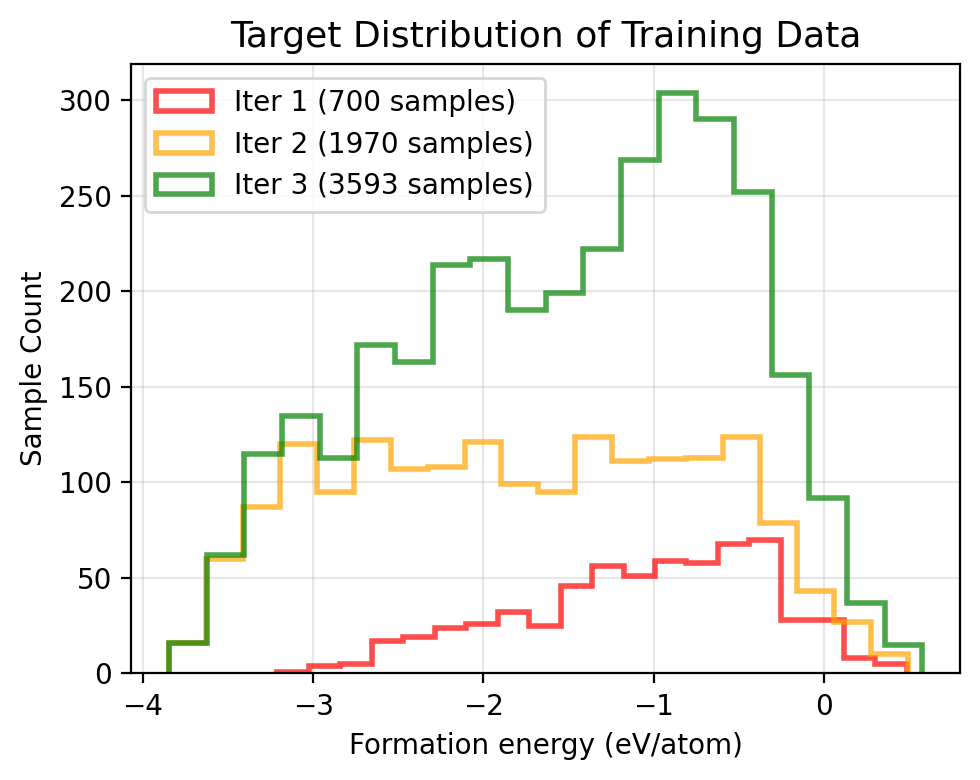

In [6]:
iter_1_train_df = pd.read_pickle("data/subset/iter1_train/iter1_train.pkl")
iter_2_train_df = pd.read_pickle("data/subset/iter2_train/iter2_train.pkl")
iter_3_train_df = pd.read_pickle("data/subset/iter3_train/iter3_train.pkl")

iter_1_train_dHf = iter_1_train_df['dHf'].values
iter_2_train_dHf = iter_2_train_df['dHf'].values
iter_3_train_dHf = iter_3_train_df['dHf'].values

# Plot density histograms for dHf values from three different training datasets
fig, ax = plt.subplots(figsize=(5, 4), dpi=200)
bins = 20
density = False
# Create histogram data for iter_1_train_dHf
ax.hist(iter_1_train_dHf, bins=bins, density=density, histtype='step', linewidth=2, label='Iter 1 (700 samples)', color='red', alpha=0.7)
ax.hist(iter_2_train_dHf, bins=bins, density=density, histtype='step', linewidth=2, label='Iter 2 (1970 samples)', color='orange', alpha=0.7)
ax.hist(iter_3_train_dHf, bins=bins, density=density, histtype='step', linewidth=2, label='Iter 3 (3593 samples)', color='green', alpha=0.7)
#ax.set_yscale('log')
ax.set_xlabel('Formation energy (eV/atom)', fontsize=10)
ax.set_ylabel('Sample Count', fontsize=10)
ax.legend(fontsize=10)
ax.grid(True, alpha=0.3)
ax.tick_params(axis='y', labelsize=10)
ax.tick_params(axis='x', labelsize=10)
ax.set_title('Target Distribution of Training Data', fontsize=13)
plt.tight_layout()
plt.show()

### Test Set Definition and Sample Identification

Loading identifiers for different test subsets used in the evaluation:

- **ITS (Initially Chosen Test Set)**: Fixed test set
- **HU (High Uncertainty)**: Samples identified as having high prediction uncertainty
- **LU (Low Uncertainty)**: Samples identified as having low prediction uncertainty

These test sets are designed to evaluate model performance across different uncertainty regimes and provide insights into how models handle various types of materials data. The methodology is detailed in the paper "Leveraging Domain Adaptation for Accurate Machine Learning Predictions of New Halide Perovskites".

In [7]:
its_iter_1_csv = pd.read_csv(r'data\raw\its_iteration_1.csv')
its_iter_1_jids = its_iter_1_csv['file_name'].tolist()
its_iter_1_jids = [jid.replace('.cif', '') for jid in its_iter_1_jids]
its_iter_2_csv = pd.read_csv(r'data\raw\its_iteration_2.csv')
its_iter_2_jids = its_iter_2_csv['file_name'].tolist()
its_iter_2_jids = [jid.replace('.cif', '') for jid in its_iter_2_jids]
its_iter_3_csv = pd.read_csv(r'data\raw\its_iteration_3.csv')
its_iter_3_jids = its_iter_3_csv['file_name'].tolist()
its_iter_3_jids = [jid.replace('.cif', '') for jid in its_iter_3_jids]

HU_iter_1_csv = pd.read_csv(r'data\raw\ef_hu_iteration_1.csv')
HU_iter_1_jids = HU_iter_1_csv['file_name'].tolist()
HU_iter_1_jids = [jid.replace('.cif', '') for jid in HU_iter_1_jids]
HU_iter_2_csv = pd.read_csv(r'data\raw\ef_hu_iteration_2.csv')
HU_iter_2_jids = HU_iter_2_csv['file_name'].tolist()
HU_iter_2_jids = [jid.replace('.cif', '') for jid in HU_iter_2_jids]
HU_iter_3_csv = pd.read_csv(r'data\raw\ef_hu_iteration_3.csv')
HU_iter_3_jids = HU_iter_3_csv['file_name'].tolist()
HU_iter_3_jids = [jid.replace('.cif', '') for jid in HU_iter_3_jids]

LU_iter_1_csv = pd.read_csv(r'data\raw\ef_lu_iteration_1.csv')
LU_iter_1_jids = LU_iter_1_csv['file_name'].tolist()
LU_iter_1_jids = [jid.replace('.cif', '') for jid in LU_iter_1_jids]
LU_iter_2_csv = pd.read_csv(r'data\raw\ef_lu_iteration_2.csv')
LU_iter_2_jids = LU_iter_2_csv['file_name'].tolist()
LU_iter_2_jids = [jid.replace('.cif', '') for jid in LU_iter_2_jids]
LU_iter_3_csv = pd.read_csv(r'data\raw\ef_lu_iteration_3.csv')
LU_iter_3_jids = LU_iter_3_csv['file_name'].tolist()
LU_iter_3_jids = [jid.replace('.cif', '') for jid in LU_iter_3_jids]

print(f"its_iter_1_jids: {len(its_iter_1_jids)}")
print(f"its_iter_2_jids: {len(its_iter_2_jids)}")
print(f"its_iter_3_jids: {len(its_iter_3_jids)}")
print(f"HU_iter_1_jids: {len(HU_iter_1_jids)}")
print(f"HU_iter_2_jids: {len(HU_iter_2_jids)}")
print(f"HU_iter_3_jids: {len(HU_iter_3_jids)}")
print(f"LU_iter_1_jids: {len(LU_iter_1_jids)}")
print(f"LU_iter_2_jids: {len(LU_iter_2_jids)}")
print(f"LU_iter_3_jids: {len(LU_iter_3_jids)}")

paper_test_jids = set(its_iter_1_jids + its_iter_2_jids + its_iter_3_jids + HU_iter_1_jids + HU_iter_2_jids + HU_iter_3_jids + LU_iter_1_jids + LU_iter_2_jids + LU_iter_3_jids)

its_iter_1_jids: 270
its_iter_2_jids: 1873
its_iter_3_jids: 1877
HU_iter_1_jids: 1679
HU_iter_2_jids: 1623
HU_iter_3_jids: 790
LU_iter_1_jids: 1873
LU_iter_2_jids: 1877
LU_iter_3_jids: 948


## 3. Model Performance Evolution Analysis

### Prediction Error Trends Across Training Iterations

Analyzing how model prediction accuracy evolves as training data increases. This section examines Mean Absolute Error (MAE) trends across different test sets to understand the relationship between training data size and model performance.

**Key Finding**: A performance plateau is observed from iteration 2 to iteration 3 across all test sets, suggesting diminishing returns from additional training data beyond a certain threshold.

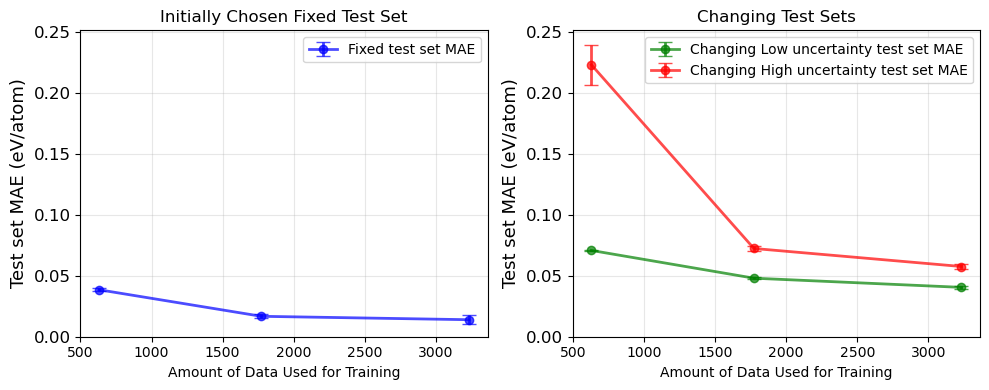

In [8]:
# Helper function to calculate MAE statistics
def calculate_mae_stats(df, jids, model_prefix):
    mae_values = []
    for i in range(1, 4):  # 1, 2, 3
        mae = df[df['jid'].isin(jids)][f'abs_err_{model_prefix}_{i}'].mean()
        mae_values.append(mae)
    return np.mean(mae_values), np.std(mae_values)

# Calculate MAE statistics for each test set and model
# Fixed ITS (using iter_1_jids for all models)
mean_mae_fixed_its_1, std_mae_fixed_its_1 = calculate_mae_stats(all_df, its_iter_1_jids, 'alignn_1')
mean_mae_fixed_its_2, std_mae_fixed_its_2 = calculate_mae_stats(all_df, its_iter_1_jids, 'alignn_2')
mean_mae_fixed_its_3, std_mae_fixed_its_3 = calculate_mae_stats(all_df, its_iter_1_jids, 'alignn_3')

# Changing ITS
mean_mae_changing_its_1, std_mae_changing_its_1 = calculate_mae_stats(all_df, its_iter_1_jids, 'alignn_1')
mean_mae_changing_its_2, std_mae_changing_its_2 = calculate_mae_stats(all_df, its_iter_2_jids, 'alignn_2')
mean_mae_changing_its_3, std_mae_changing_its_3 = calculate_mae_stats(all_df, its_iter_3_jids, 'alignn_3')

# Changing HU
mean_mae_changing_hu_1, std_mae_changing_hu_1 = calculate_mae_stats(all_df, HU_iter_1_jids, 'alignn_1')
mean_mae_changing_hu_2, std_mae_changing_hu_2 = calculate_mae_stats(all_df, HU_iter_2_jids, 'alignn_2')
mean_mae_changing_hu_3, std_mae_changing_hu_3 = calculate_mae_stats(all_df, HU_iter_3_jids, 'alignn_3')

# Changing LU
mean_mae_lu_iter_1, std_mae_lu_iter_1 = calculate_mae_stats(all_df, LU_iter_1_jids, 'alignn_1')
mean_mae_lu_iter_2, std_mae_lu_iter_2 = calculate_mae_stats(all_df, LU_iter_2_jids, 'alignn_2')
mean_mae_lu_iter_3, std_mae_lu_iter_3 = calculate_mae_stats(all_df, LU_iter_3_jids, 'alignn_3')

sample_counts = [len(iter1_train_jids), len(iter2_train_jids), len(iter3_train_jids)]

# Prepare data for plotting
mae_fixed_test = [mean_mae_fixed_its_1, mean_mae_fixed_its_2, mean_mae_fixed_its_3]
mae_its_test = [mean_mae_changing_its_1, mean_mae_changing_its_2, mean_mae_changing_its_3]
mae_HU_test = [mean_mae_changing_hu_1, mean_mae_changing_hu_2, mean_mae_changing_hu_3]
mae_LU_test = [mean_mae_lu_iter_1, mean_mae_lu_iter_2, mean_mae_lu_iter_3]

# Prepare error bars (standard deviations)
mae_fixed_test_std = [std_mae_fixed_its_1, std_mae_fixed_its_2, std_mae_fixed_its_3]
mae_its_test_std = [std_mae_changing_its_1, std_mae_changing_its_2, std_mae_changing_its_3]
mae_LU_test_std = [std_mae_lu_iter_1, std_mae_lu_iter_2, std_mae_lu_iter_3]
mae_HU_test_std = [std_mae_changing_hu_1, std_mae_changing_hu_2, std_mae_changing_hu_3]

# Create figure and subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4), dpi=None)

# Calculate y-axis limits to keep them consistent
all_values = mae_fixed_test + mae_LU_test + mae_HU_test + mae_its_test
all_errors = mae_fixed_test_std + mae_LU_test_std + mae_HU_test_std + mae_its_test_std
y_min = min([v - e for v, e in zip(all_values, all_errors)]) * 0.95
y_max = max([v + e for v, e in zip(all_values, all_errors)]) * 1.05

# Left subplot: Fixed ITS
ax1.errorbar(sample_counts, mae_fixed_test, yerr=mae_fixed_test_std, label='Fixed test set MAE', marker='o', linewidth=2, color='blue', alpha=0.7, capsize=5)
ax1.set_xlabel('Amount of Data Used for Training')
ax1.set_ylabel('Test set MAE (eV/atom)', fontsize=13)
ax1.set_title('Initially Chosen Fixed Test Set')
ax1.legend()
ax1.grid(True, alpha=0.3)
ax1.tick_params(axis='y', labelsize=12)
ax1.set_ylim(0, y_max)

# Right subplot: Changing test sets
ax2.errorbar(sample_counts, mae_LU_test, yerr=mae_LU_test_std, label='Changing Low uncertainty test set MAE', marker='o', linewidth=2, color='green', alpha=0.7, capsize=5)
ax2.errorbar(sample_counts, mae_HU_test, yerr=mae_HU_test_std, label='Changing High uncertainty test set MAE', marker='o', linewidth=2, color='red', alpha=0.7, capsize=5)
# ax2.errorbar(sample_counts, mae_its_test, yerr=mae_its_test_std, label='Changing ITS test set MAE', marker='o', linewidth=2, color='purple', alpha=0.7, capsize=5)
ax2.set_xlabel('Amount of Data Used for Training')
ax2.set_ylabel('Test set MAE (eV/atom)', fontsize=13)
ax2.set_title('Changing Test Sets')
ax2.legend()
ax2.grid(True, alpha=0.3)
ax2.tick_params(axis='y', labelsize=12)
ax2.set_ylim(0, y_max)

plt.tight_layout()
plt.show()


## 4. Hessian Eigenvalue Analysis

### Loss Landscape Curvature Characterization

Analyzing the geometric properties of the loss landscape through Hessian eigenvalue computation. For each model, eigenvalues are computed using the 250 samples with the lowest prediction error to characterize the local curvature properties around the optimal solution.

**Methodology**: Hessian eigenvalues provide insight into the optimization landscape:
- **Maximum eigenvalues**: Indicate the steepest curvature direction
- **Minimum eigenvalues**: Indicate the flattest curvature direction
- **Eigenvalue trends**: Reveal how loss landscape geometry changes with training data

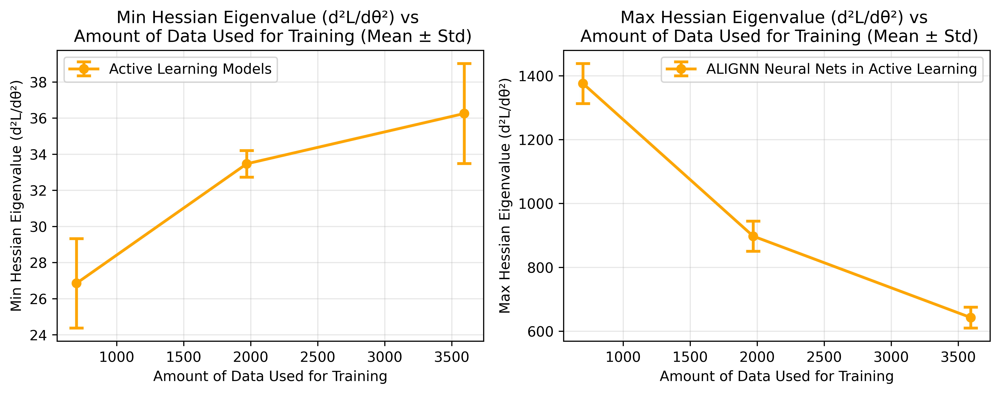

Eigenvalue Summary by Sample Count:

Sample Count: 700
------------------------------
Alignn Pruned - Max Eigenval: 26.8514 ± 2.4744, Min Eigenval: 1375.9220 ± 62.6646

Sample Count: 1970
------------------------------
Alignn Pruned - Max Eigenval: 33.4679 ± 0.7369, Min Eigenval: 897.6011 ± 47.1884

Sample Count: 3593
------------------------------
Alignn Pruned - Max Eigenval: 36.2519 ± 2.7696, Min Eigenval: 642.6545 ± 32.7435


In [9]:
eigenvalue_files_2 = [r'eigenvectors\fixed_Aug5_iter_1_alignn_1_lowest_250_error\eigenvalues.txt',
                      r'eigenvectors\fixed_Aug5_iter_1_alignn_2_lowest_250_error\eigenvalues.txt',
                      r'eigenvectors\fixed_Aug5_iter_1_alignn_3_lowest_250_error\eigenvalues.txt',
                      r'eigenvectors\fixed_Aug5_iter_2_alignn_1_lowest_250_error\eigenvalues.txt',
                      r'eigenvectors\fixed_Aug5_iter_2_alignn_2_lowest_250_error\eigenvalues.txt',
                      r'eigenvectors\fixed_Aug5_iter_2_alignn_3_lowest_250_error\eigenvalues.txt',
                      r'eigenvectors\fixed_Aug5_iter_3_alignn_1_lowest_250_error\eigenvalues.txt',
                      r'eigenvectors\fixed_Aug5_iter_3_alignn_2_lowest_250_error\eigenvalues.txt',
                      r'eigenvectors\fixed_Aug5_iter_3_alignn_3_lowest_250_error\eigenvalues.txt']
                      
max_eigenvals_2 = {}
min_eigenvals_2 = {}

pruning_levels_2 = {
    'iter_1': 700,
    'iter_2': 1970,
    'iter_3': 3593
}

for file_path in eigenvalue_files_2:
    try:
        with open(file_path, 'r') as f:
            lines = f.readlines()
            
        # Extract model name from file path
        model_name = file_path.split('\\')[-2].replace('fixed_Aug5_', '')
        model_name = model_name.replace('_lowest_250_error', '')

    
        # Parse the eigenvalue information
        for line in lines:
            if line.startswith('Maximum eigenvalue:'):
                max_eigenval = float(line.split(':')[1].strip())
                max_eigenvals_2[model_name] = max_eigenval
            elif line.startswith('Minimum eigenvalue:'):
                min_eigenval = float(line.split(':')[1].strip())
                min_eigenvals_2[model_name] = min_eigenval
                
    except FileNotFoundError:
        print(f"File not found: {file_path}")
    except Exception as e:
        print(f"Error processing {file_path}: {e}")


model_variations = ['_alignn_1', '_alignn_2', '_alignn_3']

# Organize eigenvalue data by pruning strategy and sample count
alignn_eigenvals = {}

# Collect eigenvalue data for LL pruned models
for i in range(1, 4):  # 
    base_name = f'iter_{i}'
    sample_count = pruning_levels_2[base_name]
    
    max_eigenvals_list = []
    min_eigenvals_list = []
    
    for variation in model_variations:
        model_name = base_name + variation
        if model_name in max_eigenvals_2:
            max_eigenvals_list.append(max_eigenvals_2[model_name])
            min_eigenvals_list.append(min_eigenvals_2[model_name])
    
    if max_eigenvals_list:  # If we have data for this pruning level
        alignn_eigenvals[sample_count] = {
            'max_eigenval_mean': np.mean(max_eigenvals_list),
            'max_eigenval_std': np.std(max_eigenvals_list),
            'min_eigenval_mean': np.mean(min_eigenvals_list),
            'min_eigenval_std': np.std(min_eigenvals_list)
        }

# Prepare eigenvalue data for plotting
alignn_samples = sorted(alignn_eigenvals.keys())
alignn_max_eigenval_means = [alignn_eigenvals[s]['max_eigenval_mean'] for s in alignn_samples]
alignn_max_eigenval_stds = [alignn_eigenvals[s]['max_eigenval_std'] for s in alignn_samples]
alignn_min_eigenval_means = [alignn_eigenvals[s]['min_eigenval_mean'] for s in alignn_samples]
alignn_min_eigenval_stds = [alignn_eigenvals[s]['min_eigenval_std'] for s in alignn_samples]

# Create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4), dpi=600)

# Plot Maximum Eigenvalues with error bars
ax1.errorbar(alignn_samples, alignn_max_eigenval_means, yerr=alignn_max_eigenval_stds, 
             label='Active Learning Models', marker='o', capsize=5, capthick=2, linewidth=2, color='orange')

ax1.set_xlabel('Amount of Data Used for Training')
ax1.set_ylabel('Min Hessian Eigenvalue (d²L/dθ²)')
ax1.set_title('Min Hessian Eigenvalue (d²L/dθ²) vs \n Amount of Data Used for Training (Mean ± Std)')
ax1.legend()
ax1.grid(True, alpha=0.3)

# Plot Minimum Eigenvalues with error bars
ax2.errorbar(alignn_samples, alignn_min_eigenval_means, yerr=alignn_min_eigenval_stds, 
             label='ALIGNN Neural Nets in Active Learning', marker='o', capsize=5, capthick=2, linewidth=2, color='orange')

ax2.set_xlabel('Amount of Data Used for Training')
ax2.set_ylabel('Max Hessian Eigenvalue (d²L/dθ²)')
ax2.set_title('Max Hessian Eigenvalue (d²L/dθ²) vs \n Amount of Data Used for Training (Mean ± Std)')
ax2.legend()
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Print summary statistics grouped by sample count
print("Eigenvalue Summary by Sample Count:")
print("=" * 60)

for sample_count in alignn_samples:
    print(f"\nSample Count: {sample_count}")
    print("-" * 30)
    
    # Alignn Pruned results for this sample count
    if sample_count in alignn_eigenvals:
        alignn_data = alignn_eigenvals[sample_count]
        print(f"Alignn Pruned - Max Eigenval: {alignn_data['max_eigenval_mean']:.4f} ± {alignn_data['max_eigenval_std']:.4f}, Min Eigenval: {alignn_data['min_eigenval_mean']:.4f} ± {alignn_data['min_eigenval_std']:.4f}")


## 5. Loss Landscape Visualization

### Qualitative Assessment of Loss Surface Geometry

Visualizing loss landscapes across different test subsets to understand how the optimization surface changes throughout training iterations. The loss landscapes are computed along the dominant Hessian eigenvector directions to reveal the most significant variations in the loss function.

**Key Observation**: Across all test subsets, the loss landscapes show a consistent flattening trend as training iterations progress, indicating that models converge to broader, more stable minima with increased training data.

In [10]:
# Helper for average log-loss landscape plotting
def get_avg_landscape(jids, iter_num, alignn_version=1):
    idx = np.where(np.isin(all_data_jids, jids))[0]
    if iter_num == 1:
        if alignn_version == 2:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter1_alignn2_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter1_alignn2_lowest250_error_mse_loss_landscape_array'].copy()
        elif alignn_version == 3:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter1_alignn3_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter1_alignn3_lowest250_error_mse_loss_landscape_array'].copy()
        else:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_iter1_alignn1_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_iter1_alignn1_lowest250_error_mse_loss_landscape_array'].copy()
    elif iter_num == 2:
        if alignn_version == 2:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter2_alignn2_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter2_alignn2_lowest250_error_mse_loss_landscape_array'].copy()
        elif alignn_version == 3:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter2_alignn3_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter2_alignn3_lowest250_error_mse_loss_landscape_array'].copy()
        else:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_iter2_alignn1_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_iter2_alignn1_lowest250_error_mse_loss_landscape_array'].copy()
    elif iter_num == 3:
        if alignn_version == 2:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter3_alignn2_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter3_alignn2_lowest250_error_mse_loss_landscape_array'].copy()
        elif alignn_version == 3:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter3_alignn3_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_fixed_Aug5_iter3_alignn3_lowest250_error_mse_loss_landscape_array'].copy()
        else:
            arr = loss_function_dict['fixed_Aug5_all_labeled_ON_EIGVEC_iter3_alignn1_lowest250_error_mse']['fixed_Aug5_all_labeled_ON_EIGVEC_iter3_alignn1_lowest250_error_mse_loss_landscape_array'].copy()
    else:
        raise ValueError("iter_num must be 1, 2, or 3")
    avg_landscape = np.log(np.mean(arr[idx], axis=0))
    return avg_landscape


#### 5.1 Training Set Loss Landscapes - Iter 1 training set

Examining loss landscapes for all models evaluated on the initial training set (Iteration 1 samples). This provides a consistent baseline for comparing how different models from each iteration perform on the same data subset.


In [11]:
# Get all nine landscapes
avg1_1 = get_avg_landscape(iter1_train_jids, 1, alignn_version=1)
avg1_2 = get_avg_landscape(iter1_train_jids, 1, alignn_version=2)
avg1_3 = get_avg_landscape(iter1_train_jids, 1, alignn_version=3)
avg2_1 = get_avg_landscape(iter1_train_jids, 2, alignn_version=1)
avg2_2 = get_avg_landscape(iter1_train_jids, 2, alignn_version=2)
avg2_3 = get_avg_landscape(iter1_train_jids, 2, alignn_version=3)
avg3_1 = get_avg_landscape(iter1_train_jids, 3, alignn_version=1)
avg3_2 = get_avg_landscape(iter1_train_jids, 3, alignn_version=2)
avg3_3 = get_avg_landscape(iter1_train_jids, 3, alignn_version=3)

# Find global vmin/vmax for consistent color scale
vmin = min(np.nanmin(avg1_1), np.nanmin(avg1_2), np.nanmin(avg1_3), np.nanmin(avg2_1), np.nanmin(avg2_2), np.nanmin(avg2_3), np.nanmin(avg3_1), np.nanmin(avg3_2), np.nanmin(avg3_3))
vmax = max(np.nanmax(avg1_1), np.nanmax(avg1_2), np.nanmax(avg1_3), np.nanmax(avg2_1), np.nanmax(avg2_2), np.nanmax(avg2_3), np.nanmax(avg3_1), np.nanmax(avg3_2), np.nanmax(avg3_3))

fig, axes = plt.subplots(3, 3, figsize=(21, 18), dpi=600)

titles = [
    'Training Set 1 Loss Landscape \n Model 1.1',
    'Training Set 1 Loss Landscape \n Model 1.2',
    'Training Set 1 Loss Landscape \n Model 1.3',
    'Training Set 1 Loss Landscape \n Model 2.1',
    'Training Set 1 Loss Landscape \n Model 2.2',
    'Training Set 1 Loss Landscape \n Model 2.3',
    'Training Set 1 Loss Landscape \n Model 3.1',
    'Training Set 1 Loss Landscape \n Model 3.2',
    'Training Set 1 Loss Landscape \n Model 3.3'
]
landscapes = [avg1_1, avg1_2, avg1_3, avg2_1, avg2_2, avg2_3, avg3_1, avg3_2, avg3_3]

for i, (avg_landscape, title) in enumerate(zip(landscapes, titles)):
    ax = axes[i // 3, i % 3]
    
    # Ensure avg_landscape is 2D for contour
    if avg_landscape.ndim == 3 and avg_landscape.shape[-1] == 1:
        avg_landscape_2d = np.squeeze(avg_landscape, axis=-1)
    else:
        avg_landscape_2d = avg_landscape
    
    # Create coordinate arrays for contour plotting
    x = np.arange(avg_landscape_2d.shape[1])
    y = np.arange(avg_landscape_2d.shape[0])
    X, Y = np.meshgrid(x, y)
    # Plot filled contours
    contour_filled = ax.contourf(X, Y, avg_landscape_2d, levels=15, cmap='turbo', vmin=vmin, vmax=vmax)
    # Plot contour lines
    contour_lines = ax.contour(X, Y, avg_landscape_2d, levels=15, colors='black', alpha=0.4, linewidths=0.5)
    ax.clabel(contour_lines, inline=True, fontsize=10, fmt='%.2f')
    
    ax.set_title(title, fontsize=22)
    ax.set_xlabel('X')
    if i % 3 == 0:
        ax.set_ylabel('Y')
    
    # Hide x and y ticks
    ax.set_xticks([])
    ax.set_yticks([])

# Add a single colorbar for all subplots
cbar = fig.colorbar(contour_filled, ax=axes, orientation='vertical', fraction=0.025, pad=0.04)
cbar.ax.tick_params(labelsize=22)
cbar.set_label('Log MSE Loss', fontsize=22)

plt.show()

C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `se

#### 5.2 Training Set Loss Landscapes - Progressive Evaluation

Examining loss landscapes where each model is evaluated on its corresponding training iteration data. 


In [12]:
# Get all nine landscapes
avg1_1 = get_avg_landscape(iter1_train_jids, 1, alignn_version=1)
avg1_2 = get_avg_landscape(iter1_train_jids, 1, alignn_version=2)
avg1_3 = get_avg_landscape(iter1_train_jids, 1, alignn_version=3)
avg2_1 = get_avg_landscape(iter2_train_jids, 2, alignn_version=1)
avg2_2 = get_avg_landscape(iter2_train_jids, 2, alignn_version=2)
avg2_3 = get_avg_landscape(iter2_train_jids, 2, alignn_version=3)
avg3_1 = get_avg_landscape(iter3_train_jids, 3, alignn_version=1)
avg3_2 = get_avg_landscape(iter3_train_jids, 3, alignn_version=2)
avg3_3 = get_avg_landscape(iter3_train_jids, 3, alignn_version=3)

# Find global vmin/vmax for consistent color scale
vmin = min(np.nanmin(avg1_1), np.nanmin(avg1_2), np.nanmin(avg1_3), np.nanmin(avg2_1), np.nanmin(avg2_2), np.nanmin(avg2_3), np.nanmin(avg3_1), np.nanmin(avg3_2), np.nanmin(avg3_3))
vmax = max(np.nanmax(avg1_1), np.nanmax(avg1_2), np.nanmax(avg1_3), np.nanmax(avg2_1), np.nanmax(avg2_2), np.nanmax(avg2_3), np.nanmax(avg3_1), np.nanmax(avg3_2), np.nanmax(avg3_3))

fig, axes = plt.subplots(3, 3, figsize=(21, 18), dpi=600)

titles = [
    'Training Set 1 Loss Landscape \n Model 1.1',
    'Training Set 1 Loss Landscape \n Model 1.2',
    'Training Set 1 Loss Landscape \n Model 1.3',
    'Training Set 2 Loss Landscape \n Model 2.1',
    'Training Set 2 Loss Landscape \n Model 2.2',
    'Training Set 2 Loss Landscape \n Model 2.3',
    'Training Set 3 Loss Landscape \n Model 3.1',
    'Training Set 3 Loss Landscape \n Model 3.2',
    'Training Set 3 Loss Landscape \n Model 3.3'
]
landscapes = [avg1_1, avg1_2, avg1_3, avg2_1, avg2_2, avg2_3, avg3_1, avg3_2, avg3_3]

for i, (avg_landscape, title) in enumerate(zip(landscapes, titles)):
    ax = axes[i // 3, i % 3]
    
    # Ensure avg_landscape is 2D for contour
    if avg_landscape.ndim == 3 and avg_landscape.shape[-1] == 1:
        avg_landscape_2d = np.squeeze(avg_landscape, axis=-1)
    else:
        avg_landscape_2d = avg_landscape
    
    # Create coordinate arrays for contour plotting
    x = np.arange(avg_landscape_2d.shape[1])
    y = np.arange(avg_landscape_2d.shape[0])
    X, Y = np.meshgrid(x, y)
    # Plot filled contours
    contour_filled = ax.contourf(X, Y, avg_landscape_2d, levels=15, cmap='turbo', vmin=vmin, vmax=vmax)
    # Plot contour lines
    contour_lines = ax.contour(X, Y, avg_landscape_2d, levels=15, colors='black', alpha=0.4, linewidths=0.5)
    ax.clabel(contour_lines, inline=True, fontsize=10, fmt='%.2f')
    
    ax.set_title(title, fontsize=22)
    ax.set_xlabel('X')
    if i % 3 == 0:
        ax.set_ylabel('Y')
    
    # Hide x and y ticks
    ax.set_xticks([])
    ax.set_yticks([])

# Add a single colorbar for all subplots
cbar = fig.colorbar(contour_filled, ax=axes, orientation='vertical', fraction=0.025, pad=0.04)
cbar.ax.tick_params(labelsize=22)
cbar.set_label('Log MSE Loss', fontsize=22)

plt.show()

C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `se

#### 5.3 High Uncertainty Test Set Loss Landscapes

Analyzing loss landscapes on high uncertainty holdout samples to understand model behavior in challenging prediction regions. HU set varies across iterations.


In [13]:
# Get all nine landscapes
avg1_1 = get_avg_landscape(HU_iter_1_jids, 1, alignn_version=1)
avg1_2 = get_avg_landscape(HU_iter_1_jids, 1, alignn_version=2)
avg1_3 = get_avg_landscape(HU_iter_1_jids, 1, alignn_version=3)
avg2_1 = get_avg_landscape(HU_iter_2_jids, 2, alignn_version=1)
avg2_2 = get_avg_landscape(HU_iter_2_jids, 2, alignn_version=2)
avg2_3 = get_avg_landscape(HU_iter_2_jids, 2, alignn_version=3)
avg3_1 = get_avg_landscape(HU_iter_3_jids, 3, alignn_version=1)
avg3_2 = get_avg_landscape(HU_iter_3_jids, 3, alignn_version=2)
avg3_3 = get_avg_landscape(HU_iter_3_jids, 3, alignn_version=3)

# Find global vmin/vmax for consistent color scale
vmin = min(np.nanmin(avg1_1), np.nanmin(avg1_2), np.nanmin(avg1_3), np.nanmin(avg2_1), np.nanmin(avg2_2), np.nanmin(avg2_3), np.nanmin(avg3_1), np.nanmin(avg3_2), np.nanmin(avg3_3))
vmax = max(np.nanmax(avg1_1), np.nanmax(avg1_2), np.nanmax(avg1_3), np.nanmax(avg2_1), np.nanmax(avg2_2), np.nanmax(avg2_3), np.nanmax(avg3_1), np.nanmax(avg3_2), np.nanmax(avg3_3))

fig, axes = plt.subplots(3, 3, figsize=(21, 18), dpi=600)

titles = [
    'High Uncertainty Set 1 Loss Landscape \n Model 1.1',
    'HU Set 1 Loss Landscape \n Model 1.2',
    'HU Set 1 Loss Landscape \n Model 1.3',
    'HU Set 2 Loss Landscape \n Model 2.1',
    'HU Set 2 Loss Landscape \n Model 2.2',
    'HU Set 2 Loss Landscape \n Model 2.3',
    'HU Set 3 Loss Landscape \n Model 3.1',
    'HU Set 3 Loss Landscape \n Model 3.2',
    'HU Set 3 Loss Landscape \n Model 3.3'
]
landscapes = [avg1_1, avg1_2, avg1_3, avg2_1, avg2_2, avg2_3, avg3_1, avg3_2, avg3_3]

for i, (avg_landscape, title) in enumerate(zip(landscapes, titles)):
    ax = axes[i // 3, i % 3]
    
    # Ensure avg_landscape is 2D for contour
    if avg_landscape.ndim == 3 and avg_landscape.shape[-1] == 1:
        avg_landscape_2d = np.squeeze(avg_landscape, axis=-1)
    else:
        avg_landscape_2d = avg_landscape
    
    # Create coordinate arrays for contour plotting
    x = np.arange(avg_landscape_2d.shape[1])
    y = np.arange(avg_landscape_2d.shape[0])
    X, Y = np.meshgrid(x, y)
    # Plot filled contours
    contour_filled = ax.contourf(X, Y, avg_landscape_2d, levels=15, cmap='turbo', vmin=vmin, vmax=vmax)
    # Plot contour lines
    contour_lines = ax.contour(X, Y, avg_landscape_2d, levels=15, colors='black', alpha=0.4, linewidths=0.5)
    ax.clabel(contour_lines, inline=True, fontsize=10, fmt='%.2f')
    
    ax.set_title(title, fontsize=22)
    ax.set_xlabel('X')
    if i % 3 == 0:
        ax.set_ylabel('Y')
    
    # Hide x and y ticks
    ax.set_xticks([])
    ax.set_yticks([])

# Add a single colorbar for all subplots
cbar = fig.colorbar(contour_filled, ax=axes, orientation='vertical', fraction=0.025, pad=0.04)
cbar.ax.tick_params(labelsize=22)
cbar.set_label('Log MSE Loss', fontsize=22)

plt.show()

C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `se

#### 5.4 Holdout Set Loss Landscapes

Examining loss landscapes on all holdout samples (including initial test set, LU from iter 1 to 3 and HU from iter 3).


In [14]:
# Get all nine landscapes
avg1_1 = get_avg_landscape(holdout_jids, 1, alignn_version=1)
avg1_2 = get_avg_landscape(holdout_jids, 1, alignn_version=2)
avg1_3 = get_avg_landscape(holdout_jids, 1, alignn_version=3)
avg2_1 = get_avg_landscape(holdout_jids, 2, alignn_version=1)
avg2_2 = get_avg_landscape(holdout_jids, 2, alignn_version=2)
avg2_3 = get_avg_landscape(holdout_jids, 2, alignn_version=3)
avg3_1 = get_avg_landscape(holdout_jids, 3, alignn_version=1)
avg3_2 = get_avg_landscape(holdout_jids, 3, alignn_version=2)
avg3_3 = get_avg_landscape(holdout_jids, 3, alignn_version=3)

# Find global vmin/vmax for consistent color scale
vmin = min(np.nanmin(avg1_1), np.nanmin(avg1_2), np.nanmin(avg1_3), np.nanmin(avg2_1), np.nanmin(avg2_2), np.nanmin(avg2_3), np.nanmin(avg3_1), np.nanmin(avg3_2), np.nanmin(avg3_3))
vmax = max(np.nanmax(avg1_1), np.nanmax(avg1_2), np.nanmax(avg1_3), np.nanmax(avg2_1), np.nanmax(avg2_2), np.nanmax(avg2_3), np.nanmax(avg3_1), np.nanmax(avg3_2), np.nanmax(avg3_3))

fig, axes = plt.subplots(3, 3, figsize=(21, 18), dpi=600)

titles = [
    'Holdout Set Loss Landscape \n Model 1.1',
    'Holdout Set Loss Landscape \n Model 1.2',
    'Holdout Set Loss Landscape \n Model 1.3',
    'Holdout Set Loss Landscape \n Model 2.1',
    'Holdout Set Loss Landscape \n Model 2.2',
    'Holdout Set Loss Landscape \n Model 2.3',
    'Holdout Set Loss Landscape \n Model 3.1',
    'Holdout Set Loss Landscape \n Model 3.2',
    'Holdout Set Loss Landscape \n Model 3.3'
]
landscapes = [avg1_1, avg1_2, avg1_3, avg2_1, avg2_2, avg2_3, avg3_1, avg3_2, avg3_3]

for i, (avg_landscape, title) in enumerate(zip(landscapes, titles)):
    ax = axes[i // 3, i % 3]
    
    # Ensure avg_landscape is 2D for contour
    if avg_landscape.ndim == 3 and avg_landscape.shape[-1] == 1:
        avg_landscape_2d = np.squeeze(avg_landscape, axis=-1)
    else:
        avg_landscape_2d = avg_landscape
    
    # Create coordinate arrays for contour plotting
    x = np.arange(avg_landscape_2d.shape[1])
    y = np.arange(avg_landscape_2d.shape[0])
    X, Y = np.meshgrid(x, y)
    # Plot filled contours
    contour_filled = ax.contourf(X, Y, avg_landscape_2d, levels=15, cmap='turbo', vmin=vmin, vmax=vmax)
    # Plot contour lines
    contour_lines = ax.contour(X, Y, avg_landscape_2d, levels=15, colors='black', alpha=0.4, linewidths=0.5)
    ax.clabel(contour_lines, inline=True, fontsize=10, fmt='%.2f')
    
    ax.set_title(title, fontsize=22)
    ax.set_xlabel('X')
    if i % 3 == 0:
        ax.set_ylabel('Y')
    
    # Hide x and y ticks
    ax.set_xticks([])
    ax.set_yticks([])

# Add a single colorbar for all subplots
cbar = fig.colorbar(contour_filled, ax=axes, orientation='vertical', fraction=0.025, pad=0.04)
cbar.ax.tick_params(labelsize=22)
cbar.set_label('Log MSE Loss', fontsize=22)

plt.show()

C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `se

#### 5.5 Fixed Test Set Loss Landscapes

Visualizing loss landscapes on the initially chosen fixed test set to maintain consistency across all model evaluations. This subset provides a controlled comparison point for understanding how different training iterations affect model behavior on a standardized test set.

---

## Summary and Conclusions

This comprehensive analysis reveals several key insights about ALIGNN model evolution during active learning:

1. **Performance Plateaus**: Model accuracy improvements diminish significantly after iteration 2, suggesting optimal training data size thresholds.

2. **Loss Landscape Flattening**: Consistent trends across all test sets show that loss landscapes become flatter with increased training data, indicating convergence to broader, more stable minima.

3. **Eigenvalue Evolution**: Hessian eigenvalue analysis confirms the flattening trend, with maximum eigenvalues increasing and minimum eigenvalues decreasing as training progresses.

4. **Generalization Behavior**: Similar patterns across different test subsets (high uncertainty, low uncertainty, holdout) suggest robust model evolution characteristics.

These findings provide valuable insights for optimizing active learning strategies and understanding the relationship between training data size and model optimization landscape geometry in materials science applications.


In [15]:
# Get all nine landscapes
avg1_1 = get_avg_landscape(its_iter_1_jids, 1, alignn_version=1)
avg1_2 = get_avg_landscape(its_iter_1_jids, 1, alignn_version=2)
avg1_3 = get_avg_landscape(its_iter_1_jids, 1, alignn_version=3)
avg2_1 = get_avg_landscape(its_iter_1_jids, 2, alignn_version=1)
avg2_2 = get_avg_landscape(its_iter_1_jids, 2, alignn_version=2)
avg2_3 = get_avg_landscape(its_iter_1_jids, 2, alignn_version=3)
avg3_1 = get_avg_landscape(its_iter_1_jids, 3, alignn_version=1)
avg3_2 = get_avg_landscape(its_iter_1_jids, 3, alignn_version=2)
avg3_3 = get_avg_landscape(its_iter_1_jids, 3, alignn_version=3)

# Find global vmin/vmax for consistent color scale
vmin = min(np.nanmin(avg1_1), np.nanmin(avg1_2), np.nanmin(avg1_3), np.nanmin(avg2_1), np.nanmin(avg2_2), np.nanmin(avg2_3), np.nanmin(avg3_1), np.nanmin(avg3_2), np.nanmin(avg3_3))
vmax = max(np.nanmax(avg1_1), np.nanmax(avg1_2), np.nanmax(avg1_3), np.nanmax(avg2_1), np.nanmax(avg2_2), np.nanmax(avg2_3), np.nanmax(avg3_1), np.nanmax(avg3_2), np.nanmax(avg3_3))

fig, axes = plt.subplots(3, 3, figsize=(21, 18), dpi=600)

titles = [
    'Fixed Test Set Loss Landscape \n Model 1.1',
    'Fixed Test Set Loss Landscape \n Model 1.2',
    'Fixed Test Set Loss Landscape \n Model 1.3',
    'Fixed Test Set Loss Landscape \n Model 2.1',
    'Fixed Test Set Loss Landscape \n Model 2.2',
    'Fixed Test Set Loss Landscape \n Model 2.3',
    'Fixed Test Set Loss Landscape \n Model 3.1',
    'Fixed Test Set Loss Landscape \n Model 3.2',
    'Fixed Test Set Loss Landscape \n Model 3.3'
]
landscapes = [avg1_1, avg1_2, avg1_3, avg2_1, avg2_2, avg2_3, avg3_1, avg3_2, avg3_3]

for i, (avg_landscape, title) in enumerate(zip(landscapes, titles)):
    ax = axes[i // 3, i % 3]
    
    # Ensure avg_landscape is 2D for contour
    if avg_landscape.ndim == 3 and avg_landscape.shape[-1] == 1:
        avg_landscape_2d = np.squeeze(avg_landscape, axis=-1)
    else:
        avg_landscape_2d = avg_landscape
    
    # Create coordinate arrays for contour plotting
    x = np.arange(avg_landscape_2d.shape[1])
    y = np.arange(avg_landscape_2d.shape[0])
    X, Y = np.meshgrid(x, y)
    # Plot filled contours
    contour_filled = ax.contourf(X, Y, avg_landscape_2d, levels=15, cmap='turbo', vmin=vmin, vmax=vmax)
    # Plot contour lines
    contour_lines = ax.contour(X, Y, avg_landscape_2d, levels=15, colors='black', alpha=0.4, linewidths=0.5)
    ax.clabel(contour_lines, inline=True, fontsize=10, fmt='%.2f')
    
    ax.set_title(title, fontsize=22)
    ax.set_xlabel('X')
    if i % 3 == 0:
        ax.set_ylabel('Y')
    
    # Hide x and y ticks
    ax.set_xticks([])
    ax.set_yticks([])

# Add a single colorbar for all subplots
cbar = fig.colorbar(contour_filled, ax=axes, orientation='vertical', fraction=0.025, pad=0.04)
cbar.ax.tick_params(labelsize=22)
cbar.set_label('Log MSE Loss', fontsize=22)

plt.show()

C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  avg_landscape = np.log(np.mean(arr[idx], axis=0))
C:\Users\EthanH24\AppData\Local\Temp\ipykernel_28700\1275644538.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `se